In [1]:
import pandas as pd

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

df = pd.read_csv('loan_data_2007_2014.csv')

C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\2110445332.py:7: DtypeWarning: Columns (20) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('loan_data_2007_2014.csv')


In [2]:
df

,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,...,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m
0,0,1077501,1296599,5000,5000,4975.0,36 months,10.65,162.87,B,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1077430,1314167,2500,2500,2500.0,60 months,15.27,59.83,C,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,1077175,1313524,2400,2400,2400.0,36 months,15.96,84.33,C,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,1076863,1277178,10000,10000,10000.0,36 months,13.49,339.31,C,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,1075358,1311748,3000,3000,3000.0,60 months,12.69,67.79,B,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
466280,466280,8598660,1440975,18400,18400,18400.0,60 months,14.47,432.64,C,...,NaN,NaN,NaN,NaN,NaN,NaN,29900.0,NaN,NaN,NaN
466281,466281,9684700,11536848,22000,22000,22000.0,60 months,19.97,582.50,D,...,NaN,NaN,NaN,NaN,NaN,NaN,39400.0,NaN,NaN,NaN
466282,466282,9584776,11436914,20700,20700,20700.0,60 months,16.99,514.34,D,...,NaN,NaN,NaN,NaN,NaN,NaN,13100.0,NaN,NaN,NaN
466283,466283,9604874,11457002,2000,2000,2000.0,36 months,7.90,62.59,A,...,NaN,NaN,NaN,NaN,NaN,NaN,53100.0,NaN,NaN,NaN


In [3]:
df = df.drop(df.columns[0], axis=1)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 466285 entries, 0 to 466284
Data columns (total 74 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   id                           466285 non-null  int64  
 1   member_id                    466285 non-null  int64  
 2   loan_amnt                    466285 non-null  int64  
 3   funded_amnt                  466285 non-null  int64  
 4   funded_amnt_inv              466285 non-null  float64
 5   term                         466285 non-null  object 
 6   int_rate                     466285 non-null  float64
 7   installment                  466285 non-null  float64
 8   grade                        466285 non-null  object 
 9   sub_grade                    466285 non-null  object 
 10  emp_title                    438697 non-null  object 
 11  emp_length                   445277 non-null  object 
 12  home_ownership               466285 non-null  object 
 13 

In [5]:
def get_min_value(col):
    if pd.api.types.is_numeric_dtype(col) or pd.api.types.is_datetime64_any_dtype(col):
        return col.min()
    return "-"

def get_max_value(col):
    if pd.api.types.is_numeric_dtype(col) or pd.api.types.is_datetime64_any_dtype(col):
        return col.max()
    return "-"

def get_mean_value(col):
    if pd.api.types.is_numeric_dtype(col):
        return col.mean()
    return "-"

def get_median_value(col):
    if pd.api.types.is_numeric_dtype(col):
        return col.median()
    return "-"

data_summary = pd.DataFrame({
    'Total Null': df.isna().sum(),
    'Percentage Null': df.isna().sum() * 100 / len(df),
    'Number of Unique Values': df.nunique(),
    'Data Type': df.dtypes,
    'Unique Values': df.apply(lambda col: col.dropna().unique().tolist()),
    'Mode': df.apply(lambda col: col.mode().iloc[0] if not col.mode().empty else None),
    'Min': df.apply(get_min_value),
    'Max': df.apply(get_max_value),
    'Mean': df.apply(get_mean_value),
    'Median': df.apply(get_median_value)
})

# Format Percentage Null
data_summary['Percentage Null'] = data_summary['Percentage Null'].apply(
    lambda x: f"{x:.2f}%" if x != 0 else "0%"
)

original_max_rows = pd.get_option('display.max_rows')

# Mengatur opsi tampilan untuk menampilkan DataFrame lengkap
pd.set_option('display.max_rows', None) 

data_summary


,Total Null,Percentage Null,Number of Unique Values,Data Type,Unique Values,Mode,Min,Max,Mean,Median
id,0,0%,466285,int64,"[1077501, 1077430, 1077175, 1076863, 1075358, ...",54734,54734,38098114,13079729.906182,10107897.0
member_id,0,0%,466285,int64,"[1296599, 1314167, 1313524, 1277178, 1311748, ...",70473,70473,40860827,14597660.622827,11941075.0
loan_amnt,0,0%,1352,int64,"[5000, 2500, 2400, 10000, 3000, 7000, 5600, 53...",10000,500,35000,14317.277577,12000.0
funded_amnt,0,0%,1354,int64,"[5000, 2500, 2400, 10000, 3000, 7000, 5600, 53...",10000,500,35000,14291.801044,12000.0
funded_amnt_inv,0,0%,9854,float64,"[4975.0, 2500.0, 2400.0, 10000.0, 3000.0, 5000...",10000.0,0.0,35000.0,14222.329888,12000.0
term,0,0%,2,object,"[ 36 months, 60 months]",36 months,-,-,-,-
int_rate,0,0%,506,float64,"[10.65, 15.27, 15.96, 13.49, 12.69, 7.9, 18.64...",12.99,5.42,26.06,13.829236,13.66
installment,0,0%,55622,float64,"[162.87, 59.83, 84.33, 339.31, 67.79, 156.46, ...",327.34,15.67,1409.99,432.061201,379.89
grade,0,0%,7,object,"[B, C, A, E, F, D, G]",B,-,-,-,-
sub_grade,0,0%,35,object,"[B2, C4, C5, C1, B5, A4, E1, F2, C3, B1, D1, A...",B3,-,-,-,-


In [6]:
data_summary.to_csv('data_summary.csv')

# Hapus data yang unique semua, sama semua, & terlalu banyak null

In [7]:
df = df.drop(['id','member_id','url', # unique semua
              'policy_code','application_type', # sama semua
              'desc','mths_since_last_delinq','mths_since_last_record','next_pymnt_d','mths_since_last_major_derog', #null diatas 15.07%
              'zip_code', #kurang relevan, disensor semua
              'annual_inc_joint','dti_joint','verification_status_joint','open_acc_6m','open_il_6m', #null 100%
              'open_il_12m','open_il_24m','mths_since_rcnt_il','total_bal_il','il_util','open_rv_12m',
              'open_rv_24m','max_bal_bc','all_util','inq_fi','total_cu_tl','inq_last_12m'],axis=1)

# Ubah datatype

In [8]:
df['issue_d'] = pd.to_datetime(df['issue_d'], format='%b-%y')
df['earliest_cr_line'] = pd.to_datetime(df['earliest_cr_line'], format='%b-%y')
df['last_pymnt_d'] = pd.to_datetime(df['last_pymnt_d'], format='%b-%y')
df['last_credit_pull_d'] = pd.to_datetime(df['last_credit_pull_d'], format='%b-%y')

In [9]:
pd.set_option('display.max_rows', 10) 
df

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,...,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim
0,5000,5000,4975.0,36 months,10.65,162.87,B,B2,NaN,10+ years,...,0.00,0.00,2015-01-01,171.62,2016-01-01,0.0,0.0,NaN,NaN,NaN
1,2500,2500,2500.0,60 months,15.27,59.83,C,C4,Ryder,< 1 year,...,117.08,1.11,2013-04-01,119.66,2013-09-01,0.0,0.0,NaN,NaN,NaN
2,2400,2400,2400.0,36 months,15.96,84.33,C,C5,NaN,10+ years,...,0.00,0.00,2014-06-01,649.91,2016-01-01,0.0,0.0,NaN,NaN,NaN
3,10000,10000,10000.0,36 months,13.49,339.31,C,C1,AIR RESOURCES BOARD,10+ years,...,0.00,0.00,2015-01-01,357.48,2015-01-01,0.0,0.0,NaN,NaN,NaN
4,3000,3000,3000.0,60 months,12.69,67.79,B,B5,University Medical Group,1 year,...,0.00,0.00,2016-01-01,67.79,2016-01-01,0.0,0.0,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
466280,18400,18400,18400.0,60 months,14.47,432.64,C,C2,Financial Advisor,4 years,...,0.00,0.00,2016-01-01,432.64,2016-01-01,0.0,0.0,0.0,294998.0,29900.0
466281,22000,22000,22000.0,60 months,19.97,582.50,D,D5,Chief of Interpretation (Park Ranger),10+ years,...,0.00,0.00,2014-12-01,17.50,2016-01-01,0.0,0.0,0.0,221830.0,39400.0
466282,20700,20700,20700.0,60 months,16.99,514.34,D,D1,patrol,7 years,...,0.00,0.00,2016-01-01,514.34,2015-12-01,0.0,0.0,0.0,73598.0,13100.0
466283,2000,2000,2000.0,36 months,7.90,62.59,A,A4,Server Engineer Lead,3 years,...,0.00,0.00,2014-12-01,1500.68,2015-04-01,0.0,0.0,0.0,591610.0,53100.0


In [10]:
def get_min_value(col):
    if pd.api.types.is_numeric_dtype(col) or pd.api.types.is_datetime64_any_dtype(col):
        return col.min()
    return "-"

def get_max_value(col):
    if pd.api.types.is_numeric_dtype(col) or pd.api.types.is_datetime64_any_dtype(col):
        return col.max()
    return "-"

def get_mean_value(col):
    if pd.api.types.is_numeric_dtype(col):
        return col.mean()
    return "-"

def get_median_value(col):
    if pd.api.types.is_numeric_dtype(col):
        return col.median()
    return "-"

data_summary = pd.DataFrame({
    'Total Null': df.isna().sum(),
    'Percentage Null': df.isna().sum() * 100 / len(df),
    'Number of Unique Values': df.nunique(),
    'Data Type': df.dtypes,
    'Unique Values': df.apply(lambda col: col.dropna().unique().tolist()),
    'Mode': df.apply(lambda col: col.mode().iloc[0] if not col.mode().empty else None),
    'Min': df.apply(get_min_value),
    'Max': df.apply(get_max_value),
    'Mean': df.apply(get_mean_value),
    'Median': df.apply(get_median_value)
})

# Format Percentage Null
data_summary['Percentage Null'] = data_summary['Percentage Null'].apply(
    lambda x: f"{x:.2f}%" if x != 0 else "0%"
)

original_max_rows = pd.get_option('display.max_rows')

# Mengatur opsi tampilan untuk menampilkan DataFrame lengkap
pd.set_option('display.max_rows', None) 

data_summary


,Total Null,Percentage Null,Number of Unique Values,Data Type,Unique Values,Mode,Min,Max,Mean,Median
loan_amnt,0,0%,1352,int64,"[5000, 2500, 2400, 10000, 3000, 7000, 5600, 53...",10000,500,35000,14317.277577,12000.0
funded_amnt,0,0%,1354,int64,"[5000, 2500, 2400, 10000, 3000, 7000, 5600, 53...",10000,500,35000,14291.801044,12000.0
funded_amnt_inv,0,0%,9854,float64,"[4975.0, 2500.0, 2400.0, 10000.0, 3000.0, 5000...",10000.0,0.0,35000.0,14222.329888,12000.0
term,0,0%,2,object,"[ 36 months, 60 months]",36 months,-,-,-,-
int_rate,0,0%,506,float64,"[10.65, 15.27, 15.96, 13.49, 12.69, 7.9, 18.64...",12.99,5.42,26.06,13.829236,13.66
installment,0,0%,55622,float64,"[162.87, 59.83, 84.33, 339.31, 67.79, 156.46, ...",327.34,15.67,1409.99,432.061201,379.89
grade,0,0%,7,object,"[B, C, A, E, F, D, G]",B,-,-,-,-
sub_grade,0,0%,35,object,"[B2, C4, C5, C1, B5, A4, E1, F2, C3, B1, D1, A...",B3,-,-,-,-
emp_title,27588,5.92%,205475,object,"[Ryder, AIR RESOURCES BOARD, University Medica...",Teacher,-,-,-,-
emp_length,21008,4.51%,11,object,"[10+ years, < 1 year, 1 year, 3 years, 8 years...",10+ years,-,-,-,-


In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 466285 entries, 0 to 466284
Data columns (total 46 columns):
 #   Column                      Non-Null Count   Dtype         
---  ------                      --------------   -----         
 0   loan_amnt                   466285 non-null  int64         
 1   funded_amnt                 466285 non-null  int64         
 2   funded_amnt_inv             466285 non-null  float64       
 3   term                        466285 non-null  object        
 4   int_rate                    466285 non-null  float64       
 5   installment                 466285 non-null  float64       
 6   grade                       466285 non-null  object        
 7   sub_grade                   466285 non-null  object        
 8   emp_title                   438697 non-null  object        
 9   emp_length                  445277 non-null  object        
 10  home_ownership              466285 non-null  object        
 11  annual_inc                  466281 non-

In [12]:
numeric_cols = df.select_dtypes(include=['int64', 'float64']).columns
categorical_cols = df.select_dtypes(include=['object']).columns

In [13]:
print(len(numeric_cols))
print(len(categorical_cols))

29
13


In [14]:
import matplotlib.pyplot as plt
import seaborn as sns

# Histogram

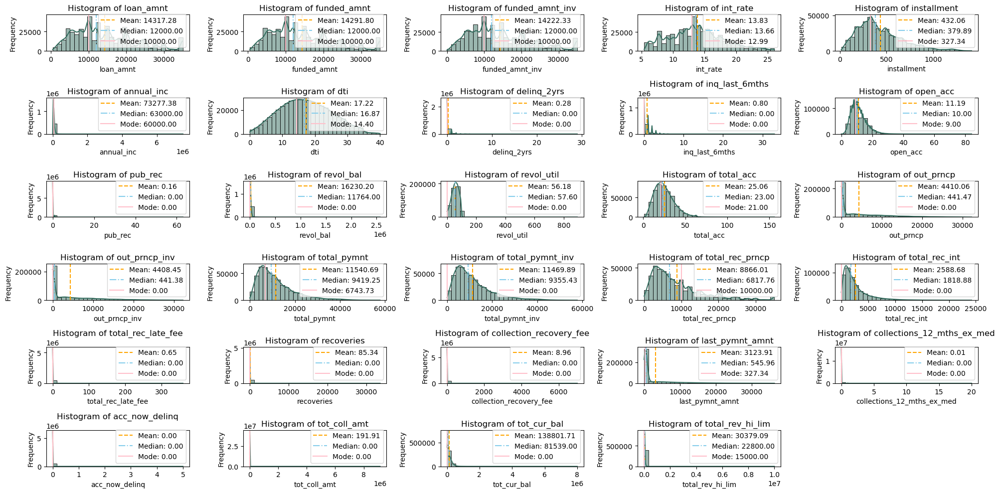

In [15]:
plt.figure(figsize=(20, 10))  # Ukuran gambar
num_cols = len(numeric_cols)
for i, col in enumerate(numeric_cols):
    plt.subplot((num_cols // 5) + 1, 5, i + 1)
    
    # Hitung mean, median, dan mode
    mean = df[col].mean()
    median = df[col].median()
    mode = df[col].mode()[0]
    
    # Histogram
    sns.histplot(df[col], bins=30, color='#366f61', kde=True)
    plt.axvline(mean, color='orange', linestyle='--', label=f'Mean: {mean:.2f}')
    plt.axvline(median, color='skyblue', linestyle='-.', label=f'Median: {median:.2f}')
    plt.axvline(mode, color='pink', linestyle='-', label=f'Mode: {mode:.2f}')
    
    plt.title(f'Histogram of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.legend()

plt.tight_layout()
plt.show()

# Boxplot

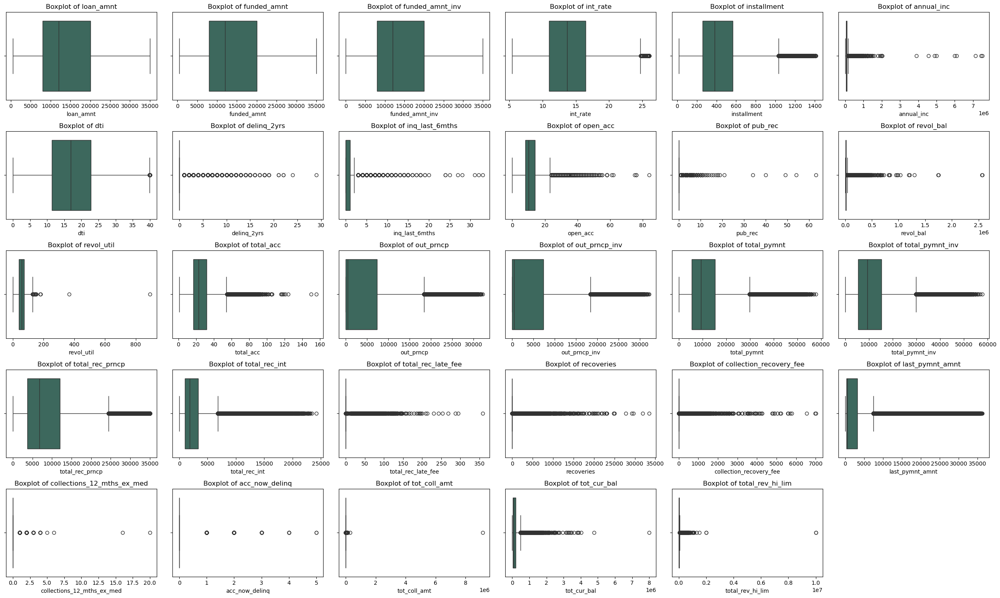

In [16]:
plt.figure(figsize=(25, 15))
for i, col in enumerate(numeric_cols):
    plt.subplot((num_cols // 6) + 1, 6, i + 1)
    
    # Boxplot
    sns.boxplot(x=df[col], color='#366f61')
    plt.title(f'Boxplot of {col}')
    plt.xlabel(col)

plt.tight_layout()
plt.show()

In [17]:
for col in categorical_cols:
    print(col)
    print(df[col].nunique())

term
2
grade
7
sub_grade
35
emp_title
205475
emp_length
11
home_ownership
6
verification_status
3
loan_status
9
pymnt_plan
2
purpose
14
title
63098
addr_state
50
initial_list_status
2


In [18]:
df['emp_title'].value_counts()

emp_title
Teacher                                                                           5399
Manager                                                                           4438
Registered Nurse                                                                  2316
RN                                                                                2204
Supervisor                                                                        1967
Project Manager                                                                   1624
Sales                                                                             1624
Owner                                                                             1527
Office Manager                                                                    1395
manager                                                                           1312
Driver                                                                            1296
General Manager                  

C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\3830585946.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(data=df, x=col, palette='viridis')


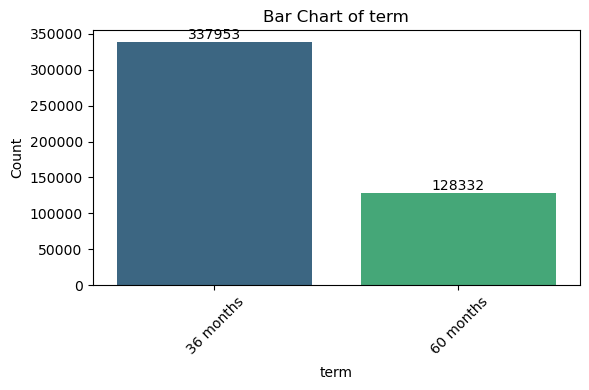

C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\3830585946.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(data=df, x=col, palette='viridis')


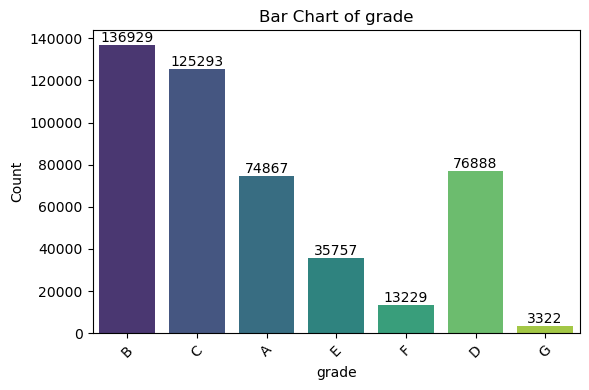

C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\3830585946.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(data=df, x=col, palette='viridis')


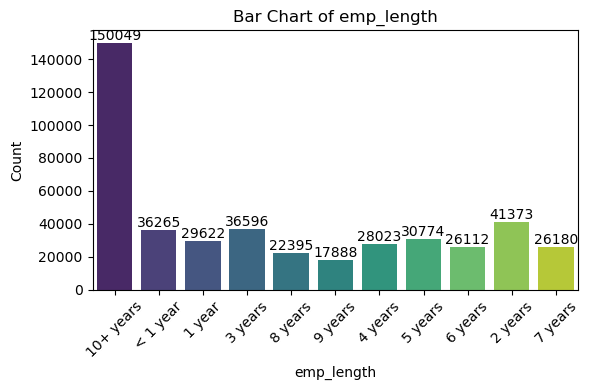

C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\3830585946.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(data=df, x=col, palette='viridis')


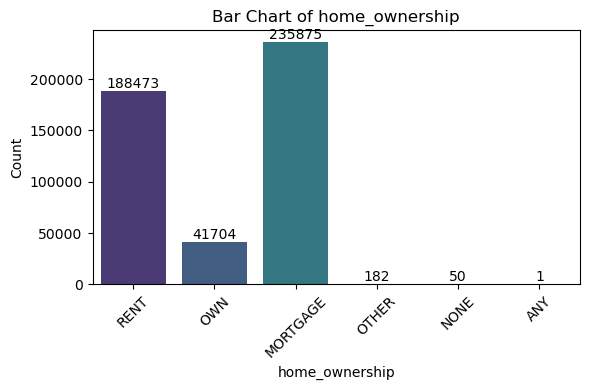

C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\3830585946.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(data=df, x=col, palette='viridis')


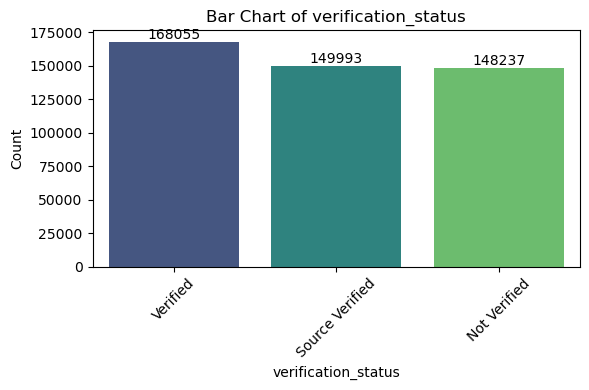

C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\3830585946.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(data=df, x=col, palette='viridis')


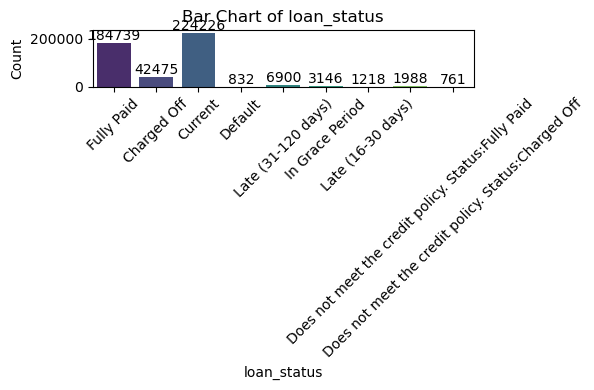

C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\3830585946.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(data=df, x=col, palette='viridis')


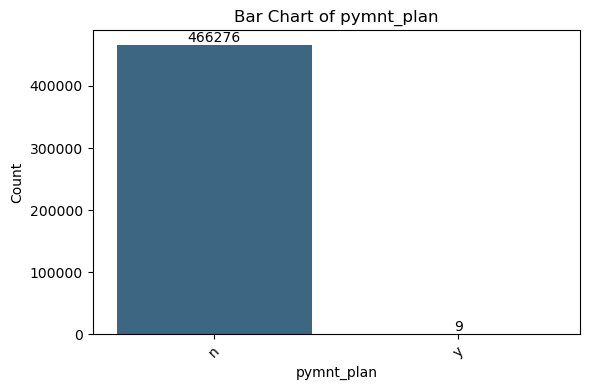

C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\3830585946.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(data=df, x=col, palette='viridis')


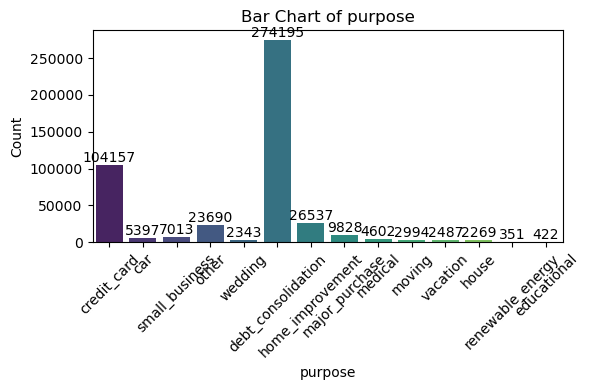

C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\3830585946.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(data=df, x=col, palette='viridis')


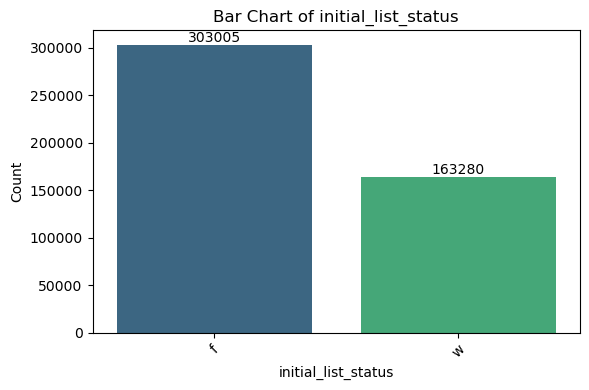

In [19]:
for col in categorical_cols:
    if df[col].nunique() <= 15:  # Hanya untuk kolom dengan nilai unik <= 15
        plt.figure(figsize=(6, 4))
        
        # Menggunakan countplot
        ax = sns.countplot(data=df, x=col, palette='viridis')
        
        plt.title(f'Bar Chart of {col}')
        plt.xlabel(col)
        plt.ylabel('Count')
        plt.xticks(rotation=45)
        
        # Menambahkan angka di atas setiap bar
        for p in ax.patches:
            ax.annotate(f'{int(p.get_height())}', 
                        (p.get_x() + p.get_width() / 2., p.get_height()), 
                        ha='center', va='bottom')
        
        plt.tight_layout()
        plt.show()

# Drop pymnt_plan

In [20]:
df = df.drop('pymnt_plan',axis=1)

# Bivariate

In [21]:
# sns.pairplot(df[numeric_cols], corner=True)  # corner=True untuk tidak duplikat atas-bawah
# plt.show()

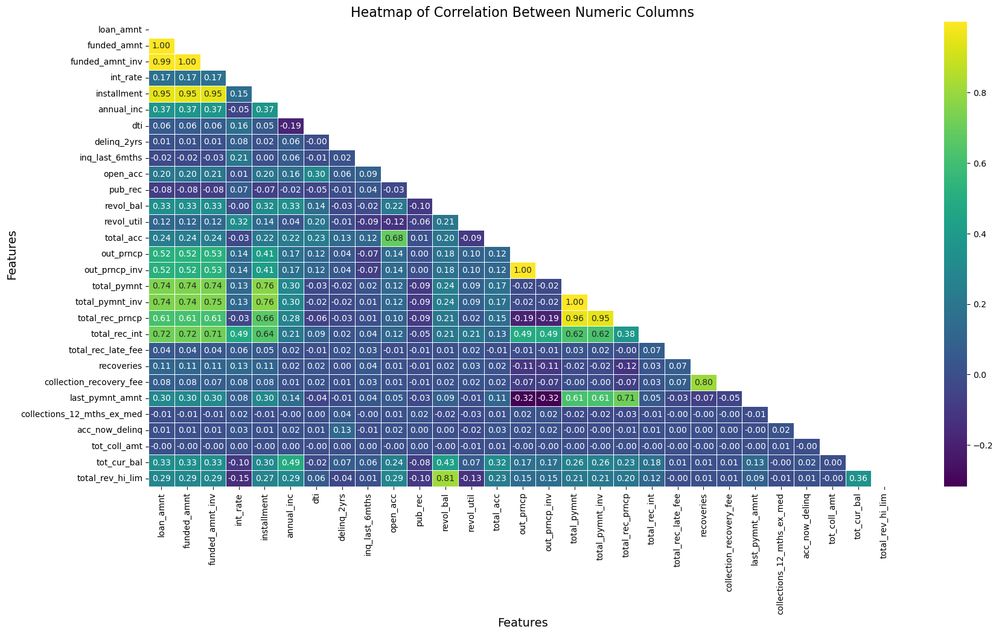

In [22]:
corr = df[numeric_cols].corr()
plt.figure(figsize=(20, 10))
sns.heatmap(corr, mask=np.triu(np.ones_like(corr, dtype=bool)), cmap='viridis', annot=True, fmt=".2f", linewidths=0.5)

# Menambahkan judul
plt.title('Heatmap of Correlation Between Numeric Columns', fontsize=16)

# Menambahkan label sumbu
plt.xlabel('Features', fontsize=14)
plt.ylabel('Features', fontsize=14)

# Menampilkan heatmap
plt.show()


C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\4110631245.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['default_flag'] = data['loan_status'].apply(lambda x: 1 if x in default_status else 0)
C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\4110631245.py:22: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=default_rate_df, x='grade', y='default_flag', palette='viridis')


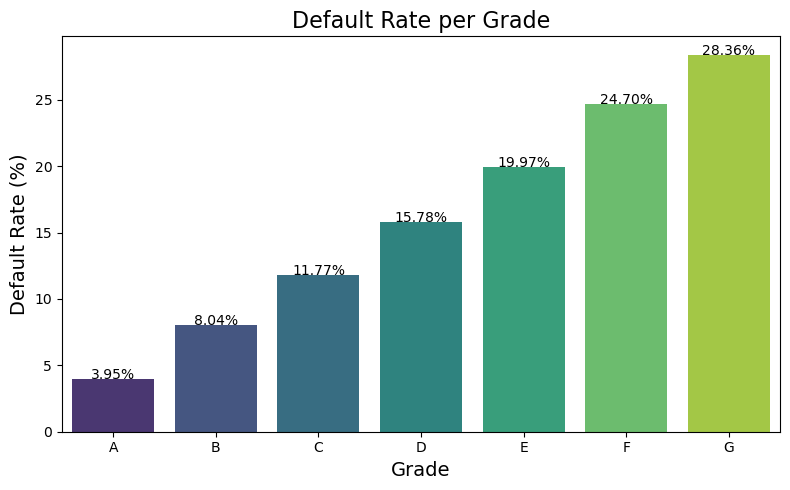

In [23]:
data = df[['grade','annual_inc','dti','loan_status']]

default_status = [
    'Charged Off',
    'Default',
    'Late (31-120 days)',
    'Late (16-30 days)',
    'Does not meet the credit policy. Status:Charged Off'
]

# Buat kolom target binary
data['default_flag'] = data['loan_status'].apply(lambda x: 1 if x in default_status else 0)

# Hitung tingkat default per grade
default_rate_grade = data.groupby('grade')['default_flag'].mean().sort_index() * 100

# Membuat DataFrame untuk visualisasi
default_rate_df = default_rate_grade.reset_index()

# Visualisasi dengan Seaborn
plt.figure(figsize=(8, 5))
sns.barplot(data=default_rate_df, x='grade', y='default_flag', palette='viridis')

# Menambahkan judul dan label
plt.title('Default Rate per Grade', fontsize=16)
plt.xlabel('Grade', fontsize=14)
plt.ylabel('Default Rate (%)', fontsize=14)

# Menampilkan nilai di atas bar
for index, row in default_rate_df.iterrows():
    plt.text(index, row['default_flag'], f'{row["default_flag"]:.2f}%', color='black', ha='center')

plt.tight_layout()
plt.show()

C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\2151185052.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['issue_year'] = df['issue_d'].dt.year
C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\2151185052.py:14: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  yearly_analysis = data.groupby('issue_year').apply(lambda x: pd.Series({


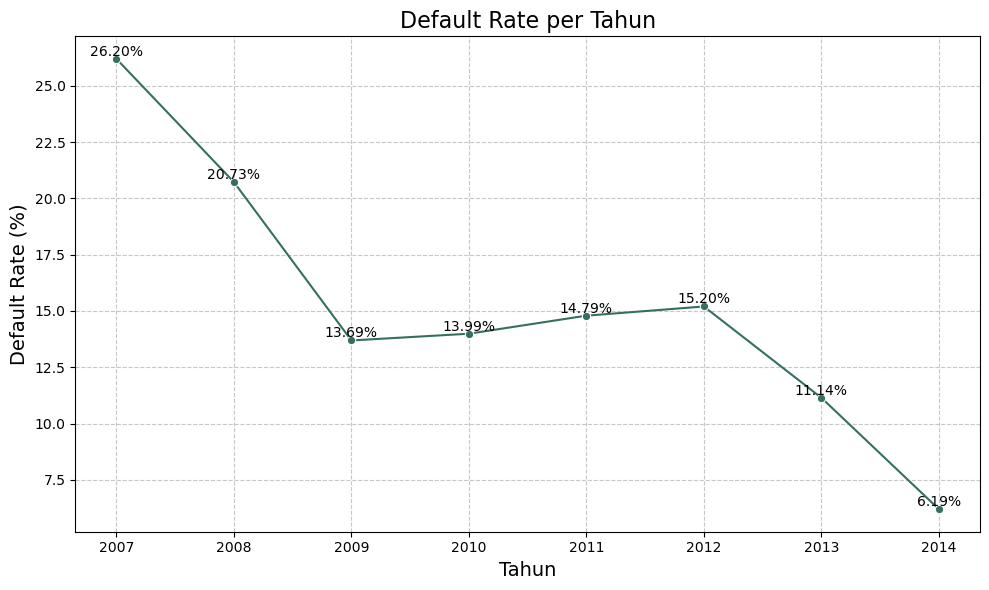

In [24]:
default_categories = ['Default', 'Charged Off', 'Does not meet the credit policy. Status:Charged Off']

data = df[['issue_d','loan_status']]

# Hitung total pinjaman
total_loans = data.shape[0]

# Hitung Default Rate Total
default_total = data[data['loan_status'].isin(default_categories)].shape[0]
default_total_rate = (default_total / total_loans) * 100

data['issue_year'] = df['issue_d'].dt.year

yearly_analysis = data.groupby('issue_year').apply(lambda x: pd.Series({
    'total_loans': len(x),
    'default_loans': len(x[x['loan_status'].isin(default_categories)])
}))

# Hitung default rate per tahun
yearly_analysis['default_rate'] = (yearly_analysis['default_loans'] / yearly_analysis['total_loans']) * 100

# Visualisasi Default Rate per Tahun menggunakan Seaborn
plt.figure(figsize=(10, 6))
sns.lineplot(data=yearly_analysis, x=yearly_analysis.index, y='default_rate', marker='o', color='#366f61')
plt.title('Default Rate per Tahun', fontsize=16)
plt.xlabel('Tahun', fontsize=14)
plt.ylabel('Default Rate (%)', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.7)

# Tambahkan label persentase di atas setiap titik
for x, y in zip(yearly_analysis.index, yearly_analysis['default_rate']):
    plt.text(x, y, f'{y:.2f}%', ha='center', va='bottom')

plt.tight_layout()
plt.show()

In [25]:
good_loans = ['Current', 'Fully Paid', 'In Grace Period', 
              'Does not meet the credit policy. Status:Fully Paid']

df['is_risky'] = np.where(df['loan_status'].isin(good_loans), 'not_risky', 'risky')

C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\1384755508.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x='is_risky', palette=custom_palette)


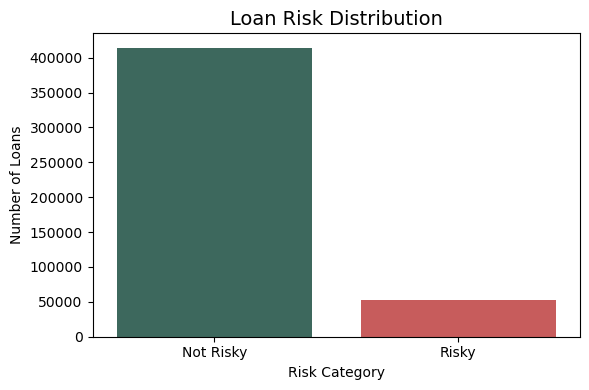

In [26]:
custom_palette = {
    'not_risky': '#366f61',  # hijau
    'risky': '#d94a4a'       # merah gelap, berlawanan
}

plt.figure(figsize=(6, 4))
sns.countplot(data=df, x='is_risky', palette=custom_palette)

plt.title('Loan Risk Distribution', fontsize=14)
plt.xlabel('Risk Category')
plt.ylabel('Number of Loans')
plt.xticks([0, 1], ['Not Risky', 'Risky'])
plt.tight_layout()
plt.show()

C:\Users\Asty\AppData\Local\Temp\ipykernel_114676\1423840198.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


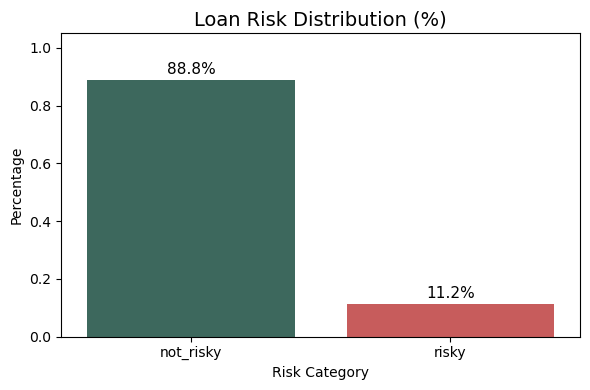

In [27]:
risk_pct = (
    df['is_risky']
    .value_counts(normalize=True)
    .rename_axis('is_risky')
    .reset_index(name='percentage')
)

# Urutkan agar not_risky di kiri
risk_pct = risk_pct.sort_values(by='is_risky', ascending=True)

custom_palette = {
    'not_risky': '#366f61',
    'risky': '#d94a4a'
}

# Plot
plt.figure(figsize=(6, 4))
sns.barplot(
    data=risk_pct,
    x='is_risky',
    y='percentage',
    palette=custom_palette
)

# Tambahkan persentase di atas bar
for index, row in risk_pct.iterrows():
    plt.text(index, row['percentage'] + 0.01, f"{row['percentage']*100:.1f}%", 
             ha='center', va='bottom', fontsize=11)

# Format plot
plt.title('Loan Risk Distribution (%)', fontsize=14)
plt.xlabel('Risk Category')
plt.ylabel('Percentage')
plt.ylim(0, 1.05)
plt.tight_layout()
plt.show()

# Save Prepared Data (Cleaning tahap 1)

In [28]:
df.to_csv('prepared_data.csv')

In [30]:
pd.set_option('display.max_rows', 10) 
df

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,...,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,last_credit_pull_d,collections_12_mths_ex_med,acc_now_delinq,tot_coll_amt,tot_cur_bal,total_rev_hi_lim,is_risky
0,5000,5000,4975.0,36 months,10.65,162.87,B,B2,NaN,10+ years,...,0.00,2015-01-01,171.62,2016-01-01,0.0,0.0,NaN,NaN,NaN,not_risky
1,2500,2500,2500.0,60 months,15.27,59.83,C,C4,Ryder,< 1 year,...,1.11,2013-04-01,119.66,2013-09-01,0.0,0.0,NaN,NaN,NaN,risky
2,2400,2400,2400.0,36 months,15.96,84.33,C,C5,NaN,10+ years,...,0.00,2014-06-01,649.91,2016-01-01,0.0,0.0,NaN,NaN,NaN,not_risky
3,10000,10000,10000.0,36 months,13.49,339.31,C,C1,AIR RESOURCES BOARD,10+ years,...,0.00,2015-01-01,357.48,2015-01-01,0.0,0.0,NaN,NaN,NaN,not_risky
4,3000,3000,3000.0,60 months,12.69,67.79,B,B5,University Medical Group,1 year,...,0.00,2016-01-01,67.79,2016-01-01,0.0,0.0,NaN,NaN,NaN,not_risky
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
466280,18400,18400,18400.0,60 months,14.47,432.64,C,C2,Financial Advisor,4 years,...,0.00,2016-01-01,432.64,2016-01-01,0.0,0.0,0.0,294998.0,29900.0,not_risky
466281,22000,22000,22000.0,60 months,19.97,582.50,D,D5,Chief of Interpretation (Park Ranger),10+ years,...,0.00,2014-12-01,17.50,2016-01-01,0.0,0.0,0.0,221830.0,39400.0,risky
466282,20700,20700,20700.0,60 months,16.99,514.34,D,D1,patrol,7 years,...,0.00,2016-01-01,514.34,2015-12-01,0.0,0.0,0.0,73598.0,13100.0,not_risky
466283,2000,2000,2000.0,36 months,7.90,62.59,A,A4,Server Engineer Lead,3 years,...,0.00,2014-12-01,1500.68,2015-04-01,0.0,0.0,0.0,591610.0,53100.0,not_risky
